IMPORT EVERYTHING

In [1]:
# Commands to install some of the libraries in-case if they are not installed
# Any other library that needs to be installed just use: !pip install <library name>
# !pip install seaborn
# !pip install missingno
# !pip install xgboost
# !pip install catboost
# !pip install regex
# !pip install sklearn
# !pip install pandas
# !pip install numpy
# !pip install imblearn
# pip install lightgbm
# !pip install --upgrade matplotlib


In [2]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction 

from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler


# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching

# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

Import additional items as needed...

In [3]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, balanced_accuracy_score,\
                            precision_score, recall_score, roc_auc_score,\
                            ConfusionMatrixDisplay, classification_report, RocCurveDisplay, f1_score
from sklearn.linear_model import LinearRegression
import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

import warnings
warnings.filterwarnings("ignore")

# Exploratory Data Analysis (EDA)

## Start with Loading the CSV Data

In [4]:
diabetic = pd.read_csv('C:/Users/ttsegyal/Documents/GitHub/HHA550_Analysis/finaldata/cleaned_diabetic_data_final_presentation1.csv')


In [5]:
diabetic.head()

,Unnamed: 0,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,1,3,0,1,1,1,7,3,59,0,...,0,3,0,0,0,0,0,1,1,0
1,2,1,0,2,1,1,7,2,11,5,...,0,0,0,0,0,0,0,0,1,0
2,3,3,1,3,1,1,7,2,44,1,...,0,3,0,0,0,0,0,1,1,0
3,4,3,1,4,1,1,7,1,51,0,...,0,2,0,0,0,0,0,1,1,0
4,5,3,1,5,2,1,2,3,31,6,...,0,2,0,0,0,0,0,0,1,0


## Insights into our target variable

In [6]:
y = diabetic['readmitted']
print(f'Percentage of patient who readmitted within 30 days: % {round(y.value_counts(normalize=True)[1]*100,2)} --> ({y.value_counts()[1]} patient)\nPercentage of patient did not readmit within 30 days: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[1]} patient)')

Percentage of patient who readmitted within 30 days: % 11.23 --> (9486 patient)
Percentage of patient did not readmit within 30 days: % 88.77 --> (9486 patient)


In [7]:
fig = px.histogram(diabetic, x="readmitted", title='Readmitted', width=400, height=400)
fig.show()

There is an imbalance in the data regarding patient readmission within 30 days.

Since there is an imbalance, some metrics such as accuracy give us misleading results.



## Check For Missing Values

<AxesSubplot:>

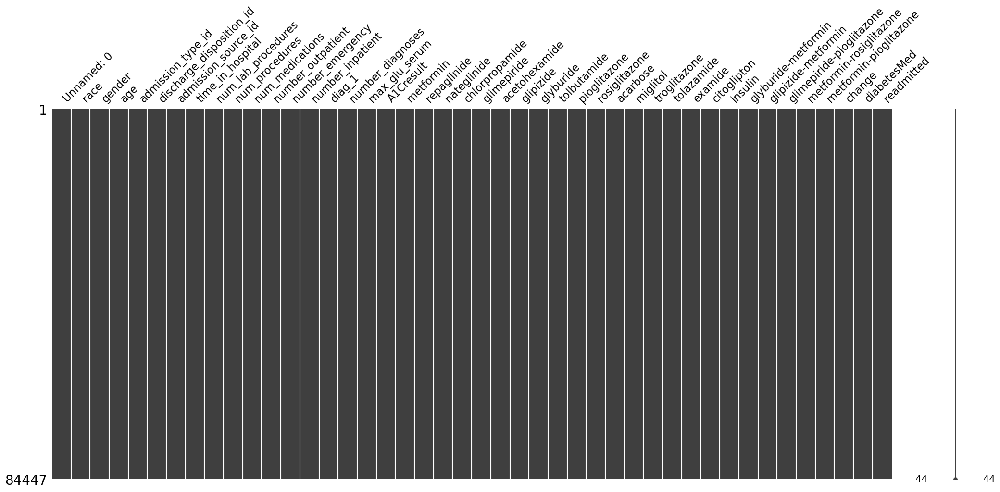

In [8]:
msno.matrix(diabetic)

No missing values.

## Decide on Metrics

Since the target data is skewed, the best metric for this binary classification problem would be Area Under the ROC Curve (AUC).

In [9]:
diabetic.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84447 entries, 0 to 84446
Data columns (total 44 columns):
 #   Column                    Non-Null Count  Dtype
---  ------                    --------------  -----
 0   Unnamed: 0                84447 non-null  int64
 1   race                      84447 non-null  int64
 2   gender                    84447 non-null  int64
 3   age                       84447 non-null  int64
 4   admission_type_id         84447 non-null  int64
 5   discharge_disposition_id  84447 non-null  int64
 6   admission_source_id       84447 non-null  int64
 7   time_in_hospital          84447 non-null  int64
 8   num_lab_procedures        84447 non-null  int64
 9   num_procedures            84447 non-null  int64
 10  num_medications           84447 non-null  int64
 11  number_outpatient         84447 non-null  int64
 12  number_emergency          84447 non-null  int64
 13  number_inpatient          84447 non-null  int64
 14  diag_1                    84447 non-nu

There are no missing values. Every column has 83254 non-null values.

## Numerical Features
    Look at the data elements using diabetic_head()
    Look at the dtype using diabetic.info()

In [10]:
diabetic.head()

,Unnamed: 0,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,1,3,0,1,1,1,7,3,59,0,...,0,3,0,0,0,0,0,1,1,0
1,2,1,0,2,1,1,7,2,11,5,...,0,0,0,0,0,0,0,0,1,0
2,3,3,1,3,1,1,7,2,44,1,...,0,3,0,0,0,0,0,1,1,0
3,4,3,1,4,1,1,7,1,51,0,...,0,2,0,0,0,0,0,1,1,0
4,5,3,1,5,2,1,2,3,31,6,...,0,2,0,0,0,0,0,0,1,0


In [11]:
diabetic.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84447 entries, 0 to 84446
Data columns (total 44 columns):
 #   Column                    Non-Null Count  Dtype
---  ------                    --------------  -----
 0   Unnamed: 0                84447 non-null  int64
 1   race                      84447 non-null  int64
 2   gender                    84447 non-null  int64
 3   age                       84447 non-null  int64
 4   admission_type_id         84447 non-null  int64
 5   discharge_disposition_id  84447 non-null  int64
 6   admission_source_id       84447 non-null  int64
 7   time_in_hospital          84447 non-null  int64
 8   num_lab_procedures        84447 non-null  int64
 9   num_procedures            84447 non-null  int64
 10  num_medications           84447 non-null  int64
 11  number_outpatient         84447 non-null  int64
 12  number_emergency          84447 non-null  int64
 13  number_inpatient          84447 non-null  int64
 14  diag_1                    84447 non-nu

Seperate Categorical and Numerical elements

In [12]:
categorical = ['race', 'gender', 'admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'diag_1', 
               'A1Cresult', 'metformin', 'repaglinide', 'nateglinide', 'chlorpropamide', 
               'glimepiride', 'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide', 'pioglitazone', 
               'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone', 'tolazamide', 'examide', 'citoglipton', 
               'insulin', 'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone', 
               'metformin-rosiglitazone', 'metformin-pioglitazone', 'change', 'diabetesMed', 'readmitted']

numerical = ['age', 'time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 
                      'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses']

In [13]:
diabetic[numerical].describe()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
count,84447.000000,84447.000000,84447.000000,84447.000000,84447.000000,84447.000000,84447.000000,84447.000000,84447.000000
mean,6.084467,4.382737,43.656234,1.340107,15.997833,0.356354,0.208521,0.652386,7.518538
std,1.604887,2.977027,19.390216,1.708996,8.121821,1.257435,0.981372,1.285440,1.912526
min,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
25%,5.000000,2.000000,33.000000,0.000000,10.000000,0.000000,0.000000,0.000000,6.000000
50%,6.000000,4.000000,45.000000,1.000000,15.000000,0.000000,0.000000,0.000000,9.000000
75%,7.000000,6.000000,57.000000,2.000000,20.000000,0.000000,0.000000,1.000000,9.000000
max,9.000000,14.000000,132.000000,6.000000,81.000000,42.000000,76.000000,21.000000,16.000000


## Skewness
    negative = left skew
    positive = right skew
    0        = no skew

In [14]:
diabetic[numerical].skew()

age                   -0.637067
time_in_hospital       1.144088
num_lab_procedures    -0.327120
num_procedures         1.317758
num_medications        1.329845
number_outpatient      8.878266
number_emergency      22.791751
number_inpatient       3.538992
number_diagnoses      -0.967006
dtype: float64

## Univariate Analysis

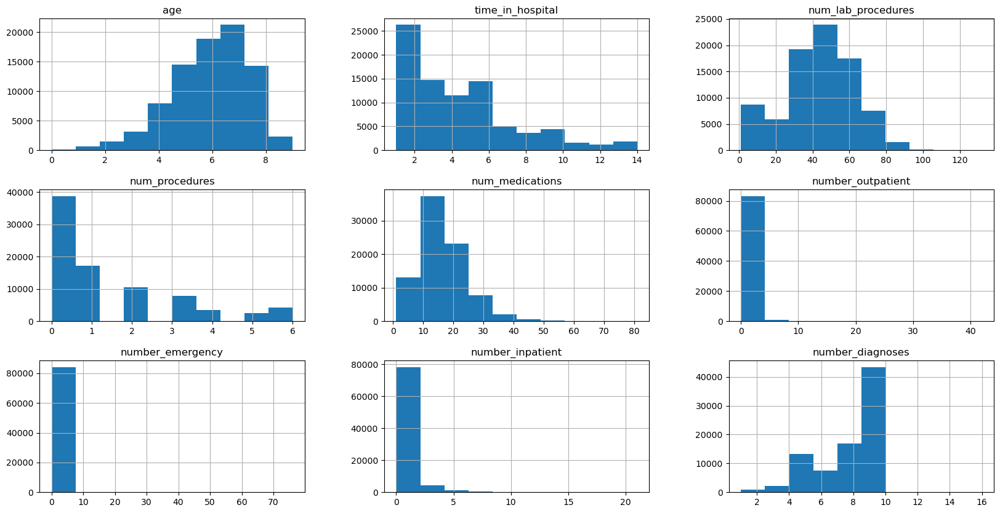

In [15]:
diabetic[numerical].hist(figsize=(20,10));

* age has a left skew
* time_in_hospital has a right skew
* num_lab_procedures has a left skew 
* num_procedures has a right skew
* num_medications has a right skew
* num_outpatient has a right skew
* number_emergency has a right skew
* number inpatient has a right skew
* number diagnoses has a left skew

## Categorical Features


In [16]:
print (f'{round(diabetic["gender"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetic, x="gender", title='Gender', width=500, height=500)
fig.show()

0    54.03
1    45.97
Name: gender, dtype: float64


In [17]:
print (f'{round(diabetic["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetic, x="race", title='race', width=600, height=600)
fig.show()

3    75.79
1    20.22
4     1.81
5     1.52
2     0.66
Name: race, dtype: float64


In [18]:
print (f'{round(diabetic["admission_type_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetic, x="admission_type_id", title='admission_type_id', width=750, height=750)
fig.show()

1    59.32
3    20.69
2    19.95
7     0.02
4     0.01
Name: admission_type_id, dtype: float64


In [19]:
print (f'{round(diabetic["A1Cresult"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetic, x="A1Cresult", title='A1Cresult', width=750, height=750)
fig.show()

0    82.97
3     7.94
1     5.27
2     3.82
Name: A1Cresult, dtype: float64


In [20]:
print (f'{round(diabetic["diabetesMed"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetic, x="diabetesMed", title='diabetesMed', width=750, height=750)
fig.show()

1    77.54
0    22.46
Name: diabetesMed, dtype: float64


In [21]:
print (f'{round(diabetic["insulin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetic, x="insulin", title='insulin', width=750, height=750)
fig.show()

0    45.23
2    31.03
1    12.55
3    11.19
Name: insulin, dtype: float64


In [22]:
print (f'{round(diabetic["age"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetic, x="age", title='age', width=750, height=750)
fig.show()

7    25.10
6    22.31
5    17.09
8    16.94
4     9.44
3     3.75
9     2.75
2     1.70
1     0.74
0     0.17
Name: age, dtype: float64


## Bivariate Analysis

### Gender and Readmission

In [23]:
print (f'A male has a probability of {round(diabetic[diabetic["gender"]==1]["readmitted"].mean()*100,2)} % to readmit within 30 days')

print()

print (f'A female has a probability of  {round(diabetic[diabetic["gender"]==0]["readmitted"].mean()*100,2)} % to readmit within 30 days')

A male has a probability of 11.16 % to readmit within 30 days

A female has a probability of  11.3 % to readmit within 30 days


In [24]:
fig = px.histogram(diabetic, x="gender", color="readmitted",width=600, height=600)
fig.show()

### Race and Readmission

In [25]:
print (f'A Caucasian has a probability of {round(diabetic[diabetic["race"]==3]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A African American has a probability of {round(diabetic[diabetic["race"]==1]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A Asian has a probability of {round(diabetic[diabetic["race"]==2]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A Hispanic has a probability of {round(diabetic[diabetic["race"]==4]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A Other has a probability of {round(diabetic[diabetic["race"]==5]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()






A Caucasian has a probability of 11.36 % of readmitting within 30 days

A African American has a probability of 11.06 % of readmitting within 30 days

A Asian has a probability of 10.38 % of readmitting within 30 days

A Hispanic has a probability of 9.56 % of readmitting within 30 days

A Other has a probability of 9.45 % of readmitting within 30 days



In [26]:
fig = px.histogram(diabetic, x="race", color="readmitted",width=600, height=600)
fig.show()

### Admission Type and Readmission

In [27]:
print (f'A patient admitted for "Emergency" has a probability of {round(diabetic[diabetic["admission_type_id"]==1]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A patient admitted for "Urgent" has a probability of {round(diabetic[diabetic["admission_type_id"]==2]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A patient admitted for "Elective" has a probability of {round(diabetic[diabetic["admission_type_id"]==3]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A patient admitted for "Newborn" has a probability of {round(diabetic[diabetic["admission_type_id"]==4]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A patient admitted for "Trauma Center" has a probability of {round(diabetic[diabetic["admission_type_id"]==7]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()


A patient admitted for "Emergency" has a probability of 11.54 % of readmitting within 30 days

A patient admitted for "Urgent" has a probability of 11.26 % of readmitting within 30 days

A patient admitted for "Elective" has a probability of 10.35 % of readmitting within 30 days

A patient admitted for "Newborn" has a probability of 10.0 % of readmitting within 30 days

A patient admitted for "Trauma Center" has a probability of 0.0 % of readmitting within 30 days



In [28]:

fig = px.histogram(diabetic, x="admission_type_id", color="readmitted",width=600, height=600)
fig.show()

### A1CResult and Readmission

In [29]:
print (f'A patient with an A1Cresult of "None" has a probability of {round(diabetic[diabetic["A1Cresult"]==0]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A patient with an A1Cresult of "Norm" has a probability of {round(diabetic[diabetic["A1Cresult"]==1]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A patient with an A1Cresult of ">7" has a probability of {round(diabetic[diabetic["A1Cresult"]==2]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()

print (f'A patient with an A1Cresult of ">8" has a probability of {round(diabetic[diabetic["A1Cresult"]==3]["readmitted"].mean()*100,2)} % of readmitting within 30 days')

print()


A patient with an A1Cresult of "None" has a probability of 11.53 % of readmitting within 30 days

A patient with an A1Cresult of "Norm" has a probability of 9.55 % of readmitting within 30 days

A patient with an A1Cresult of ">7" has a probability of 10.04 % of readmitting within 30 days

A patient with an A1Cresult of ">8" has a probability of 9.84 % of readmitting within 30 days



In [30]:
fig = px.histogram(diabetic, x="A1Cresult", color="readmitted",width=600, height=600)
fig.show()

## Metrics of Importance
### Mutual Info Score

In [31]:
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, diabetic['readmitted']) 

diabetic_cat = diabetic[categorical].apply(cat_mut_inf) 
diabetic_cat = diabetic_cat.sort_values(ascending=False).to_frame(name='mutual_info_score') 
diabetic_cat

,mutual_info_score
readmitted,3.513609e-01
discharge_disposition_id,8.159116e-03
insulin,1.011328e-03
diag_1,1.000959e-03
diabetesMed,3.780887e-04
change,2.860761e-04
metformin,2.782392e-04
admission_source_id,2.582642e-04
A1Cresult,2.226939e-04
admission_type_id,1.375703e-04


In [32]:
diabetic[numerical].corr()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
age,1.000000,0.107300,0.031678,-0.022395,0.047998,0.020251,-0.088964,-0.041148,0.254452
time_in_hospital,0.107300,1.000000,0.326188,0.188776,0.469876,-0.000524,-0.006881,0.069348,0.231017
num_lab_procedures,0.031678,0.326188,1.000000,0.035141,0.280833,0.021724,0.010634,0.042225,0.158492
num_procedures,-0.022395,0.188776,0.035141,1.000000,0.375691,-0.019010,-0.037061,-0.067005,0.069733
num_medications,0.047998,0.469876,0.280833,0.375691,1.000000,0.046070,0.014358,0.068944,0.263503
number_outpatient,0.020251,-0.000524,0.021724,-0.019010,0.046070,1.000000,0.093707,0.117058,0.093438
number_emergency,-0.088964,-0.006881,0.010634,-0.037061,0.014358,0.093707,1.000000,0.270503,0.049938
number_inpatient,-0.041148,0.069348,0.042225,-0.067005,0.068944,0.117058,0.270503,1.000000,0.105193
number_diagnoses,0.254452,0.231017,0.158492,0.069733,0.263503,0.093438,0.049938,0.105193,1.000000


There are barely any correlation between numerical features.

In [33]:
diabetic.groupby('readmitted')[numerical].mean()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
readmitted,,,,,,,,,
0,6.073505,4.336842,43.514067,1.347914,15.884246,0.347114,0.187337,0.576847,7.483785
1,6.171094,4.745414,44.779675,1.278410,16.895425,0.429370,0.375922,1.249315,7.793169


In [34]:
diabetic[['age', 'time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 
                      'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'readmitted']].corr()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses,readmitted
age,1.000000,0.107300,0.031678,-0.022395,0.047998,0.020251,-0.088964,-0.041148,0.254452,0.019202
time_in_hospital,0.107300,1.000000,0.326188,0.188776,0.469876,-0.000524,-0.006881,0.069348,0.231017,0.043338
num_lab_procedures,0.031678,0.326188,1.000000,0.035141,0.280833,0.021724,0.010634,0.042225,0.158492,0.020611
num_procedures,-0.022395,0.188776,0.035141,1.000000,0.375691,-0.019010,-0.037061,-0.067005,0.069733,-0.012842
num_medications,0.047998,0.469876,0.280833,0.375691,1.000000,0.046070,0.014358,0.068944,0.263503,0.039314
number_outpatient,0.020251,-0.000524,0.021724,-0.019010,0.046070,1.000000,0.093707,0.117058,0.093438,0.020657
number_emergency,-0.088964,-0.006881,0.010634,-0.037061,0.014358,0.093707,1.000000,0.270503,0.049938,0.060681
number_inpatient,-0.041148,0.069348,0.042225,-0.067005,0.068944,0.117058,0.270503,1.000000,0.105193,0.165195
number_diagnoses,0.254452,0.231017,0.158492,0.069733,0.263503,0.093438,0.049938,0.105193,1.000000,0.051082
readmitted,0.019202,0.043338,0.020611,-0.012842,0.039314,0.020657,0.060681,0.165195,0.051082,1.000000


* When age increases, the mean score on the readmitted also increases.
* Correlations with the target variable are very small.


In [35]:
fig = px.scatter(diabetic, x='age', y='number_diagnoses', title='Age & # of Diagnoses ',color='readmitted', hover_data = diabetic[['readmitted']])
fig.show()

In [36]:
fig = px.scatter(diabetic, x='num_lab_procedures', y='num_medications', title='# Lab Procedures and Medications',color='readmitted', hover_data = diabetic[['readmitted']])
fig.show()

## Converting Categorical Features into Numeric Features

In [37]:
diabetic = pd.get_dummies(diabetic, drop_first = False)

## Breaking the data up into Train and Test

In [38]:
train_df, valid_df, test_df = np.split(diabetic.sample(frac=1, random_state=42), 
                                       [int(.7*len(diabetic)), int(0.85*len(diabetic))])
train_df = train_df.reset_index(drop = True)
valid_df = valid_df.reset_index(drop = True)
test_df = test_df.reset_index(drop = True)

In [39]:
diabetic.readmitted.value_counts()

0    74961
1     9486
Name: readmitted, dtype: int64

In [40]:
train_df.readmitted.value_counts()

0    52499
1     6613
Name: readmitted, dtype: int64

In [41]:
valid_df.readmitted.value_counts()

0    11230
1     1437
Name: readmitted, dtype: int64

In [42]:
test_df.readmitted.value_counts()

0    11232
1     1436
Name: readmitted, dtype: int64

## Treating the Imbalance in Data
Imbalance in the data means that one of the classes in the data is too less as compared to the others. Typically, it is better to balance the data in some way to give the positives more weight. There are 3 strategies that are typically utilized:

Sub-sample the more dominant class: use a random subset of the negatives
Over-sample the imbalanced class: use the same positive samples multiple times
Create synthetic positive data
Usually, you will want to use the latter two methods if you only have a handful of positive cases. Since we have a few thousand positive cases, let's use the sub-sample approach. Here, we will create a balanced training data set that has 50% positive and 50% negative. You can also play with this ratio to see if you can get an improvement.

In [43]:
def calc_prevalence(y_actual):
    
    '''
    This function is to understand the ratio/distribution of the classes that we are going to predict for.
    
    Params:
    1. y_actual: The target feature
    
    Return:
    1. (sum(y_actual)/len(y_actual)): The ratio of the postive class in the comlpete data.
    '''
    
    return (sum(y_actual)/len(y_actual))

In [44]:
# split the training data into positive and negative
rows_pos = train_df.readmitted == 1
df_train_pos = train_df.loc[rows_pos]
df_train_neg = train_df.loc[~rows_pos]

# merge the balanced data
sample_size = min(len(df_train_pos), len(df_train_neg))
diabetic_df_balanced = pd.concat([df_train_pos, df_train_neg.sample(n=sample_size, random_state=111)], axis=0)

# shuffle the order of training samples 
diabetic_df_balanced = diabetic_df_balanced.sample(n=len(diabetic_df_balanced), random_state=42).reset_index(drop=True)

print('Train balanced prevalence(n=%d):%.3f'%(len(diabetic_df_balanced), \
                                                calc_prevalence(diabetic_df_balanced.readmitted.values)))


Train balanced prevalence(n=13226):0.500


In [45]:
diabetic_df_balanced.readmitted.value_counts()

1    6613
0    6613
Name: readmitted, dtype: int64

In [46]:
X_train = diabetic_df_balanced.drop('readmitted',axis=1)

y_train = diabetic_df_balanced['readmitted']

X_valid = valid_df.drop('readmitted',axis=1)

y_valid = valid_df['readmitted']

X_test = test_df.drop('readmitted',axis=1)

y_test = test_df['readmitted']

In [47]:
scaler=StandardScaler()
X_train[['race', 'gender', 'age', 'admission_type_id', 'time_in_hospital', 'num_lab_procedures', 'A1Cresult', 'diabetesMed', 'number_inpatient']] = pd.DataFrame(scaler.fit_transform(X_train[['race', 'gender', 'age', 'admission_type_id', 'time_in_hospital', 'num_lab_procedures', 'A1Cresult', 'diabetesMed', 'number_inpatient']]),columns=['race', 'gender', 'age', 'admission_type_id', 'time_in_hospital', 'num_lab_procedures', 'A1Cresult', 'diabetesMed', 'number_inpatient'])
X_valid[['race', 'gender', 'age', 'admission_type_id', 'time_in_hospital', 'num_lab_procedures', 'A1Cresult', 'diabetesMed', 'number_inpatient']] = pd.DataFrame(scaler.transform(X_valid[['race', 'gender', 'age', 'admission_type_id', 'time_in_hospital', 'num_lab_procedures', 'A1Cresult', 'diabetesMed', 'number_inpatient']]),columns=['race', 'gender', 'age', 'admission_type_id', 'time_in_hospital', 'num_lab_procedures', 'A1Cresult', 'diabetesMed', 'number_inpatient'])
X_test[['race', 'gender', 'age', 'admission_type_id', 'time_in_hospital', 'num_lab_procedures', 'A1Cresult', 'diabetesMed', 'number_inpatient']] = pd.DataFrame(scaler.transform(X_test[['race', 'gender', 'age', 'admission_type_id', 'time_in_hospital', 'num_lab_procedures', 'A1Cresult', 'diabetesMed', 'number_inpatient']]),columns=['race', 'gender', 'age', 'admission_type_id', 'time_in_hospital', 'num_lab_procedures', 'A1Cresult', 'diabetesMed', 'number_inpatient'])

## Creating and Understanding Models

In [48]:
def calc_specificity(y_actual, y_pred, thresh):
    # calculates specificity
    return sum((y_pred < thresh) & (y_actual == 0)) /sum(y_actual ==0)

def print_report(y_actual, y_pred, thresh = 0.5):
    
    '''
    This function calculates all the metrics to asses the machine learning models.
    
    Params:
    1. y_actual: The actual values for the target variable.
    2. y_pred: The predicted values for the target variable.
    3. thresh: The threshold for the probability to be considered as a positive class. Default value 0.5
    
    Return:
    1. AUC
    2. Accuracy
    3. Recall
    4. Precision
    5. Specificity
    '''
    
    auc = roc_auc_score(y_actual, y_pred)
    accuracy = accuracy_score(y_actual, (y_pred > thresh))
    recall = recall_score(y_actual, (y_pred > thresh))
    precision = precision_score(y_actual, (y_pred > thresh))
    specificity = calc_specificity(y_actual, y_pred, thresh)
    print('AUC:%.3f'%auc)
    print('accuracy:%.3f'%accuracy)
    print('recall:%.3f'%recall)
    print('precision:%.3f'%precision)
    print('specificity:%.3f'%specificity)
    print('prevalence:%.3f'%calc_prevalence(y_actual))
    print(' ')
    return auc, accuracy, recall, precision, specificity

## Linear Regression

In [49]:
lnr = LinearRegression()
lnr.fit(X_train, y_train)


y_valid_preds = lnr.predict(X_valid)

In [50]:
y_valid_preds

array([0.69345324, 0.41855594, 0.76909945, ..., 0.49366581, 0.49793699,
       0.431336  ])

In [51]:
diabetic['readmitted'].value_counts()

0    74961
1     9486
Name: readmitted, dtype: int64

## Logisitic Regression

In [52]:
lr=LogisticRegression(random_state = 42, solver = 'newton-cg', max_iter = 200)
lr.fit(X_train, y_train)

y_valid_preds = lr.predict_proba(X_valid)[:,1]

print('Metrics for Validation data:')

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,y_valid_preds, 0.5)

Metrics for Validation data:
AUC:0.644
accuracy:0.662
recall:0.515
precision:0.171
specificity:0.680
prevalence:0.113
 


In [69]:
importance = abs(lr.coef_[0])
indices = np.argsort(importance)[::-1][:5]
features = X_train.columns

print('Top 5 important variables:')
for i in indices:
    print(features[i], importance[i])


Top 5 important variables:
tolbutamide 0.6828403886452374
tolazamide 0.6622420552947959
number_inpatient 0.4558641439441758
miglitol 0.450726150822803
chlorpropamide 0.17886755046821876


## Explaining Results

## KNN Model

In [53]:
knn = KNeighborsClassifier(n_neighbors = 100)
knn.fit(X_train, y_train)

knn_preds = knn.predict_proba(X_valid)[:,1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,knn_preds, 0.5)

AUC:0.492
accuracy:0.508
recall:0.473
precision:0.110
specificity:0.440
prevalence:0.113
 


In [54]:
sgdc=SGDClassifier(loss = 'log',alpha = 0.1,random_state = 42)
sgdc.fit(X_train, y_train)

sgd_preds = sgdc.predict_proba(X_valid)[:,1]

print('Stochastic Gradient Descent')
print('Validation:')
sgdc_valid_auc, sgdc_valid_accuracy, sgdc_valid_recall, \
                sgdc_valid_precision, sgdc_valid_specificity = print_report(y_valid,sgd_preds, 0.5)

Stochastic Gradient Descent
Validation:
AUC:0.499
accuracy:0.885
recall:0.003
precision:0.121
specificity:0.997
prevalence:0.113
 


In [55]:
dc_clf = DecisionTreeClassifier(random_state=42, max_depth = 10)
dc_clf.fit(X_train, y_train)

dc_preds_proba = dc_clf.predict_proba(X_valid)[:,1]
dc_preds = dc_clf.predict(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,dc_preds_proba, 0.5)

AUC:0.621
accuracy:0.576
recall:0.617
precision:0.156
specificity:0.556
prevalence:0.113
 


In [71]:
importance = dc_clf.feature_importances_
indices = np.argsort(importance)[::-1][:5]
features = X_train.columns

print('Top 5 important variables:')
for i in indices:
    print(features[i], importance[i])


Top 5 important variables:
number_inpatient 0.2048007112320039
discharge_disposition_id 0.17745895981290255
Unnamed: 0 0.1157032083947385
num_medications 0.06891705668441435
num_lab_procedures 0.06413676475721254


In [56]:
rf_clf = RandomForestClassifier(random_state=111, max_depth = 6)

rf_clf.fit(X_train, y_train)

rf_preds = rf_clf.predict(X_valid)
rf_preds_proba = rf_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,rf_preds_proba, 0.5)

AUC:0.664
accuracy:0.599
recall:0.644
precision:0.168
specificity:0.593
prevalence:0.113
 


In [73]:
rf_clf = RandomForestClassifier(random_state=111, max_depth = 6)
rf_clf.fit(X_train, y_train)

importance = rf_clf.feature_importances_
indices = np.argsort(importance)[::-1][:5]
features = X_train.columns

print('Top 5 important variables:')
for i in indices:
    print(features[i], importance[i])


Top 5 important variables:
number_inpatient 0.3027234895031829
discharge_disposition_id 0.16583873959191758
number_emergency 0.06512290444808795
num_medications 0.05209133801434666
number_diagnoses 0.049957598848719365


In [57]:
lsvc_clf = LinearSVC(random_state=111)
lsvc_clf.fit(X_train, y_train)

lsvc_preds = lsvc_clf.decision_function(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,lsvc_preds, 0.5)

AUC:0.505
accuracy:0.466
recall:0.554
precision:0.115
specificity:0.455
prevalence:0.113
 


In [74]:
importance = np.abs(lsvc_clf.coef_[0])
indices = np.argsort(importance)[::-1][:5]
features = X_train.columns

print('Top 5 important variables:')
for i in indices:
    print(features[i], importance[i])


Top 5 important variables:
glipizide 0.38051558147800224
repaglinide 0.2831918207274753
insulin 0.26767970627960863
discharge_disposition_id 0.17605645074214205
diag_1 0.15263113545111517


In [58]:
gb_clf = GradientBoostingClassifier(n_estimators = 100, criterion='friedman_mse', learning_rate = 1.0, max_depth = 3,\
                                    random_state = 111)

gb_clf.fit(X_train, y_train)
gb_preds = gb_clf.predict(X_valid)
gb_preds_proba = gb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,gb_preds_proba, 0.5)

AUC:0.624
accuracy:0.599
recall:0.571
precision:0.156
specificity:0.603
prevalence:0.113
 


In [75]:
importance = gb_clf.feature_importances_
indices = np.argsort(importance)[::-1][:5]
features = X_train.columns

print('Top 5 important variables:')
for i in indices:
    print(features[i], importance[i])


Top 5 important variables:
number_inpatient 0.20490491754041215
discharge_disposition_id 0.18498586187035362
Unnamed: 0 0.17238080928960015
num_medications 0.061659386563249624
num_lab_procedures 0.05533059284011798


In [59]:
xgb_clf = xgb.XGBClassifier(max_depth=3, learning_rate = 1.0, use_label_encoder = False,\
                            eval_metric = 'logloss')
xgb_clf.fit(X_train, y_train)

xgb_preds = xgb_clf.predict(X_valid)
xgb_preds_proba = xgb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,xgb_preds_proba, 0.5)

AUC:0.644
accuracy:0.603
recall:0.601
precision:0.162
specificity:0.603
prevalence:0.113
 


In [76]:
importance = xgb_clf.feature_importances_
indices = np.argsort(importance)[::-1][:5]
features = X_train.columns

print('Top 5 important variables:')
for i in indices:
    print(f"{features[i]}: {importance[i]}")


Top 5 important variables:
number_inpatient: 0.17011776566505432
discharge_disposition_id: 0.11107609421014786
diabetesMed: 0.043642546981573105
number_diagnoses: 0.03618649020791054
glimepiride: 0.035833075642585754


In [60]:
catb=CatBoostClassifier(iterations=200, depth=3, learning_rate=1.0, random_state = 111)
catb.fit(X_train, y_train)
catb_preds = catb.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,catb_preds, 0.5)

0:	learn: 0.6648965	total: 163ms	remaining: 32.4s
1:	learn: 0.6600847	total: 169ms	remaining: 16.7s
2:	learn: 0.6526058	total: 174ms	remaining: 11.5s
3:	learn: 0.6509617	total: 180ms	remaining: 8.8s
4:	learn: 0.6483122	total: 189ms	remaining: 7.35s
5:	learn: 0.6457996	total: 195ms	remaining: 6.32s
6:	learn: 0.6449968	total: 200ms	remaining: 5.51s
7:	learn: 0.6437398	total: 206ms	remaining: 4.95s
8:	learn: 0.6425606	total: 212ms	remaining: 4.5s
9:	learn: 0.6416257	total: 218ms	remaining: 4.15s
10:	learn: 0.6407779	total: 224ms	remaining: 3.85s
11:	learn: 0.6395777	total: 230ms	remaining: 3.61s
12:	learn: 0.6381783	total: 236ms	remaining: 3.39s
13:	learn: 0.6373445	total: 243ms	remaining: 3.23s
14:	learn: 0.6362202	total: 248ms	remaining: 3.06s
15:	learn: 0.6351042	total: 255ms	remaining: 2.94s
16:	learn: 0.6342171	total: 261ms	remaining: 2.81s
17:	learn: 0.6333739	total: 267ms	remaining: 2.7s
18:	learn: 0.6323785	total: 273ms	remaining: 2.6s
19:	learn: 0.6316892	total: 278ms	remaining: 

In [61]:
recall_scoring = make_scorer(recall_score)

In [62]:
dc_grid = {'max_features':['auto','sqrt'], # maximum number of features to use at each split
           'max_depth':range(1,11,1), # maximum depth of the tree
           'min_samples_split':range(2,10,2), # minimum number of samples to split a node
           'criterion':['gini','entropy']} # criterion for evaluating a split

dc_random = RandomizedSearchCV(estimator = dc_clf, param_distributions = dc_grid, 
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

dc_random.fit(X_train, y_train)

dc_random.best_params_

dc_hp_preds = dc_random.best_estimator_.predict(X_valid)
dc_hp_preds_proba = dc_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, dc_hp_preds_proba)

Fitting 2 folds for each of 20 candidates, totalling 40 fits


0.5322862696909251

In [63]:
recall_score(y_valid, dc_hp_preds)

0.6798886569241476

In [64]:
xgb_grid = params = {
        'min_child_weight': [1, 5, 8, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 0.9, 1.0],
        'max_depth': [3, 4, 5]
        } # criterion for evaluating a split

xgb_random = GridSearchCV(estimator = xgb_clf, param_grid = xgb_grid, 
                               cv = 2, scoring = recall_scoring,
                               verbose = 1)

xgb_random.fit(X_train, y_train)

xgb_random.best_params_

xgb_hp_preds = xgb_random.best_estimator_.predict(X_valid)
xgb_hp_preds_proba = xgb_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, xgb_hp_preds_proba)

Fitting 2 folds for each of 720 candidates, totalling 1440 fits


0.6503800772238096

In [65]:
recall_score(y_valid, xgb_hp_preds)

0.6026443980514962

In [67]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, roc_auc_score, accuracy_score, recall_score, precision_score, confusion_matrix
import numpy as np

# define the parameter grid to search over
param_grid = {
    'n_estimators': [50, 100, 200, 400],
    'max_depth': [6, 8, 10, 12],
    'max_features': ['sqrt', 'log2', None]
}

# create a function to calculate all the evaluation metrics
def print_report(y_true, y_pred_prob, threshold):
    y_pred = (y_pred_prob >= threshold).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    auc = roc_auc_score(y_true, y_pred_prob)
    accuracy = accuracy_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    specificity = tn / (tn + fp)
    prevalence = np.mean(y_true)
    print("AUC:{:.3f}".format(auc))
    print("accuracy:{:.3f}".format(accuracy))
    print("recall:{:.3f}".format(recall))
    print("precision:{:.3f}".format(precision))
    print("specificity:{:.3f}".format(specificity))
    print("prevalence:{:.3f}".format(prevalence))

# create the random forest classifier with default parameters
rf_clf = RandomForestClassifier(random_state=111)

# create a dictionary to store the evaluation metrics for each combination of hyperparameters
results = {}

# perform a grid search to find the best combination of hyperparameters
clf = GridSearchCV(rf_clf, param_grid, scoring=make_scorer(roc_auc_score), cv=3, n_jobs=-1)
clf.fit(X_train, y_train)

# print the best hyperparameters and their corresponding scores
print("Best hyperparameters: ", clf.best_params_)
best_clf = clf.best_estimator_
rf_preds_proba = best_clf.predict_proba(X_valid)[:, 1]
print_report(y_valid, rf_preds_proba, 0.5)


Best hyperparameters:  {'max_depth': 8, 'max_features': None, 'n_estimators': 400}
AUC:0.677
accuracy:0.618
recall:0.640
precision:0.176
specificity:0.616
prevalence:0.113


In [77]:
importances = best_clf.feature_importances_
indices = np.argsort(importances)[::-1]
for f in range(X_train.shape[1]):
    print("%d. %s (%f)" % (f + 1, X_train.columns[indices[f]], importances[indices[f]]))


1. number_inpatient (0.247874)
2. discharge_disposition_id (0.205119)
3. Unnamed: 0 (0.115085)
4. num_lab_procedures (0.063052)
5. num_medications (0.049177)
6. diag_1 (0.044430)
7. number_diagnoses (0.036120)
8. age (0.034839)
9. time_in_hospital (0.031476)
10. num_procedures (0.020109)
11. number_emergency (0.019629)
12. insulin (0.014202)
13. number_outpatient (0.013103)
14. race (0.012987)
15. admission_type_id (0.011377)
16. A1Cresult (0.009909)
17. admission_source_id (0.009892)
18. diabetesMed (0.009203)
19. metformin (0.008833)
20. glyburide (0.006809)
21. gender (0.006416)
22. glipizide (0.006240)
23. change (0.005559)
24. glimepiride (0.004852)
25. pioglitazone (0.004828)
26. rosiglitazone (0.003217)
27. repaglinide (0.003032)
28. nateglinide (0.000901)
29. max_glu_serum (0.000898)
30. glyburide-metformin (0.000579)
31. acarbose (0.000244)
32. chlorpropamide (0.000007)
33. tolazamide (0.000003)
34. miglitol (0.000000)
35. troglitazone (0.000000)
36. examide (0.000000)
37. cit